<center>
<h1><b>Lab 4</b></h1>
<h1>PHYS 580 - Computational Physics</h1>
<h2>Professor Molnar</h2>
</br>
<h3><b>Ethan Knox</b></h3>
<h4>https://www.github.com/ethank5149</h4>
<h4>ethank5149@gmail.com</h4>
</br>
</br>
<h3><b>September 24, 2020</b></h3>
</center>

### Imports

In [1]:
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from functools import partial

from scipy.integrate import solve_ivp

### Global Constants

In [12]:
_l = _g = 9.81   # Pendulum length / gravity
_q = 0.5        # Damping coefficient
_A = 1.2        # Driving 'force' amplitude
_wd = 2 / 3     # driving angular frequency [rad/s]
_phi = 0        # Poincare Phase
_N = 10000      # Poincare Section Sample Size
_theta0  = 0.2  # initial angle wrt to vertical [rad]
_dtheta0  = 0   # initial angular velocity [rad/s]

_w0 = np.sqrt(_g/_l)

### Support Functions

In [13]:
def df_nonlinear_pendulum(t, x, dx, zeta, w0, A, wd):
    return -2 * zeta * w0 * dx - w0 ** 2 * np.sin(x) + A * np.sin(wd * t)

## Custom dsolve function using Euler-Cromer
def dsolve(f, t, y0, dy0):
    t = np.asarray(t)
    y0 = np.asarray(y0)

    y = np.zeros((np.size(t), np.size(y0)))
    dy = np.zeros((np.size(t), np.size(dy0)))
    y[0] = y0
    dy[0] = dy0

    for i in range(np.size(t)-1):    
        dy[i+1] = dy[i] + f(t[i], y[i], dy[i]) * (t[i + 1] - t[i])
        y[i+1] = y[i] + dy[i + 1] * (t[i + 1] - t[i])
    return y, dy

In [14]:
def create_poincare(N=_N, state0=(_theta0, _dtheta0), phase_cut=_phi, l=_l, g=_g, q=_q, A=_A, wd=_wd, sectioning_freq=_wd):
    theta0, dtheta0 = state0  # unpack
    w0 = np.sqrt(g/l)  # conversion to a more general form
    zeta = q / (2 * w0)  # conversion to a more general form

    dt = 2 * np.pi / sectioning_freq
    t_i = (2 * np.pi + phase_cut) / sectioning_freq
    t_f = (2 * np.pi * N + phase_cut) / sectioning_freq  # stop after an integer multiple of the driving frequency plus the phase offset

    df = lambda t, y : np.asarray([y[1], -2 * zeta * w0 * y[1] - w0 ** 2 * np.sin(y[0]) + A * np.sin(wd * t)])
    sol = solve_ivp(df, [0, t_f], [theta0, dtheta0], t_eval=np.arange(t_i, t_f, dt))#, method=VelocityVerlet)
    
    t = sol.t
    theta, omega = sol.y  # unpack
    theta = np.mod(theta + np.pi, 2 * np.pi) - np.pi  # Constrain theta to [-pi, pi]

    m = I = 1
    energy = m * g * l * (1-np.cos(theta)) + 0.5 * m * l ** 2 * omega ** 2
    return t, theta, omega, energy

# Problem 1

In [15]:
t11, theta11, omega11, energy11 = create_poincare()

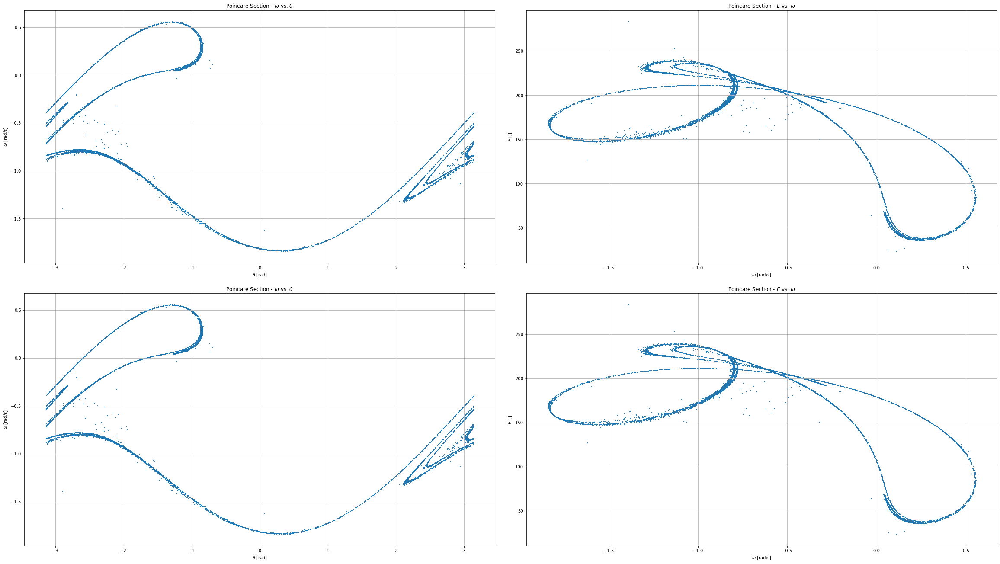

In [16]:
fig, ax = plt.subplots(2, 2, figsize=(32,18), constrained_layout=True)

ax[0,0].scatter(theta11, omega11, s = 1, marker=',')
ax[0,0].set_title(r'Poincare Section - $\omega$ vs. $\theta$')
ax[0,0].set_xlabel(r"$\theta$ [rad]")
ax[0,0].set_ylabel(r"$\omega$ [rad/s]")
ax[0,0].grid()
ax[0,1].scatter(omega11, energy11, s = 1, marker=',')
ax[0,1].set_title(r'Poincare Section - $E$ vs. $\omega$')
ax[0,1].set_xlabel(r"$\omega$ [rad/s]")
ax[0,1].set_ylabel(r"$E$ [J]")
ax[0,1].grid()

ax[1,0].scatter(theta11, omega11, s = 1, marker=',')
ax[1,0].set_title(r'Poincare Section - $\omega$ vs. $\theta$')
ax[1,0].set_xlabel(r"$\theta$ [rad]")
ax[1,0].set_ylabel(r"$\omega$ [rad/s]")
ax[1,0].grid()
ax[1,1].scatter(omega11, energy11, s = 1, marker=',')
ax[1,1].set_title(r'Poincare Section - $E$ vs. $\omega$')
ax[1,1].set_xlabel(r"$\omega$ [rad/s]")
ax[1,1].set_ylabel(r"$E$ [J]")
ax[1,1].grid()

plt.savefig('problem1.png', dpi=600)
# plt.show()

# Problem 2

In [7]:
t21, theta21, omega21, energy21 = create_poincare(state0=(np.pi/4, 0))
t22, theta22, omega22, energy22 = create_poincare(state0=(np.pi/4, np.pi/4))

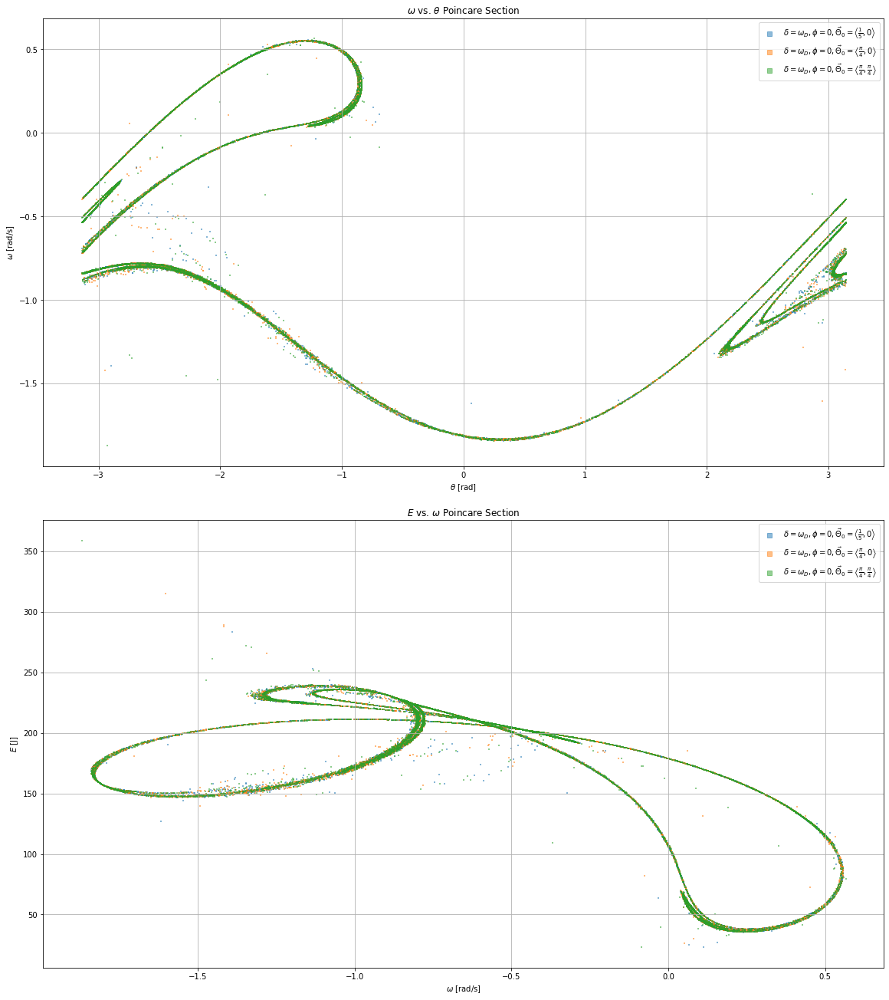

In [8]:
fig, ax = plt.subplots(2, 1, figsize=(16,18), constrained_layout=True)

ax[0].set_title(r'$\omega$ vs. $\theta$ Poincare Section')
ax[0].scatter(theta11, omega11, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[0].scatter(theta21, omega21, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{\pi}{4},0\right>$')
ax[0].scatter(theta22, omega22, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{\pi}{4},\frac{\pi}{4}\right>$')
ax[0].set_xlabel(r"$\theta$ [rad]")
ax[0].set_ylabel(r"$\omega$ [rad/s]")
ax[0].grid()
lgnd0 = ax[0].legend(scatterpoints=1, fontsize=10)
for handle in lgnd0.legendHandles:
    handle._sizes = [30]

ax[1].set_title(r'$E$ vs. $\omega$ Poincare Section')
ax[1].scatter(omega11, energy11, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[1].scatter(omega21, energy21, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{\pi}{4},0\right>$')
ax[1].scatter(omega22, energy22, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{\pi}{4},\frac{\pi}{4}\right>$')
ax[1].set_xlabel(r"$\omega$ [rad/s]")
ax[1].set_ylabel(r"$E$ [J]")
ax[1].grid()
lgnd1 = ax[1].legend(scatterpoints=1, fontsize=10)
for handle in lgnd1.legendHandles:
    handle._sizes = [30]

plt.savefig('problem2.png', dpi=600)
# plt.show()

# Problem 3

In [9]:
t31, theta31, omega31, energy31 = create_poincare(phase_cut=np.pi/2)
t32, theta32, omega32, energy32 = create_poincare(phase_cut=np.pi)
t33, theta33, omega33, energy33 = create_poincare(phase_cut=37*np.pi/180)

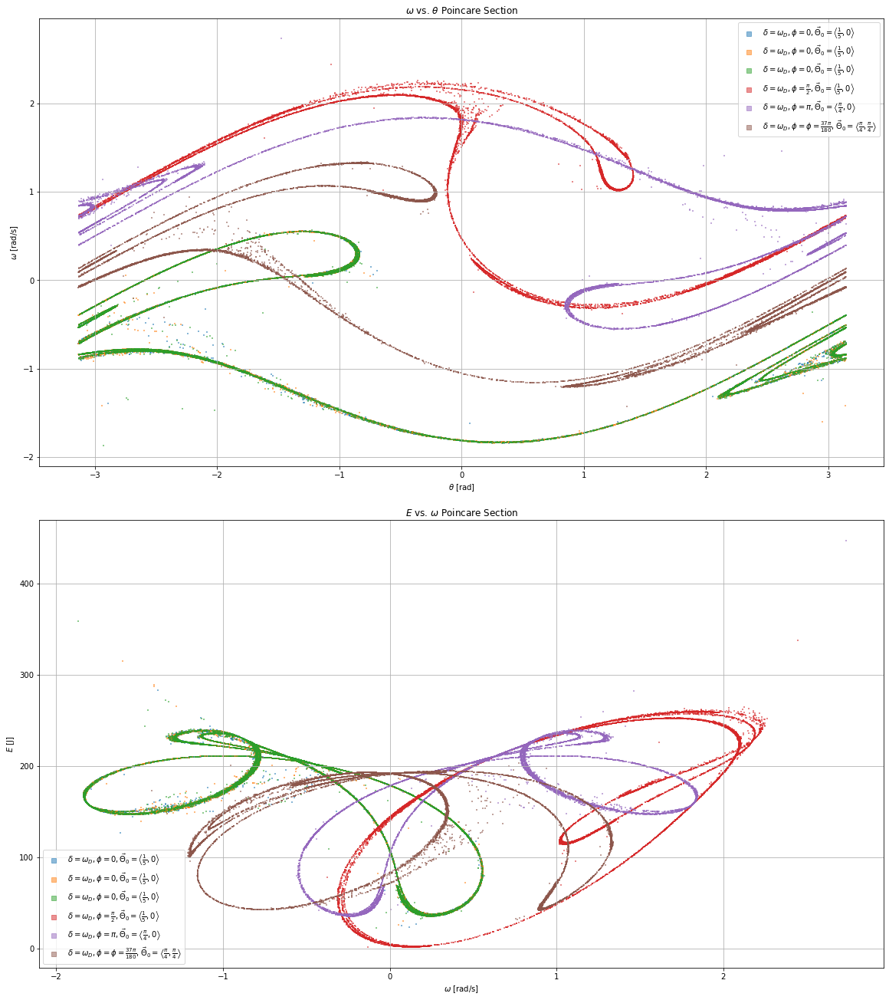

In [10]:
fig, ax = plt.subplots(2, 1, figsize=(16,18), constrained_layout=True)

ax[0].set_title(r'$\omega$ vs. $\theta$ Poincare Section')
ax[0].scatter(theta11, omega11, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[0].scatter(theta21, omega21, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[0].scatter(theta22, omega22, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[0].scatter(theta31, omega31, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=\frac{\pi}{2},\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[0].scatter(theta32, omega32, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=\pi,\vec{\Theta}_0=\left<\frac{\pi}{4},0\right>$')
ax[0].scatter(theta33, omega33, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=\phi=\frac{37\pi}{180},\vec{\Theta}_0=\left<\frac{\pi}{4},\frac{\pi}{4}\right>$')
ax[0].set_xlabel(r"$\theta$ [rad]")
ax[0].set_ylabel(r"$\omega$ [rad/s]")
ax[0].grid()
lgnd0 = ax[0].legend(scatterpoints=1, fontsize=10)
for handle in lgnd0.legendHandles:
    handle._sizes = [30]

ax[1].set_title(r'$E$ vs. $\omega$ Poincare Section')
ax[1].scatter(omega11, energy11, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[1].scatter(omega21, energy21, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[1].scatter(omega22, energy22, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[1].scatter(omega31, energy31, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=\frac{\pi}{2},\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[1].scatter(omega32, energy32, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=\pi,\vec{\Theta}_0=\left<\frac{\pi}{4},0\right>$')
ax[1].scatter(omega33, energy33, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=\phi=\frac{37\pi}{180},\vec{\Theta}_0=\left<\frac{\pi}{4},\frac{\pi}{4}\right>$')
ax[1].set_xlabel(r"$\omega$ [rad/s]")
ax[1].set_ylabel(r"$E$ [J]")
ax[1].grid()
lgnd1 = ax[1].legend(scatterpoints=1, fontsize=10)
for handle in lgnd1.legendHandles:
    handle._sizes = [30]

plt.savefig('problem3.png', dpi=600)
# plt.show()

# Problem 4

In [11]:
t41, theta41, omega41, energy41 = create_poincare(sectioning_freq=np.sqrt(np.pi/2)*_w0)
t42, theta42, omega42, energy42 = create_poincare(sectioning_freq=np.sqrt(np.e)*_w0)

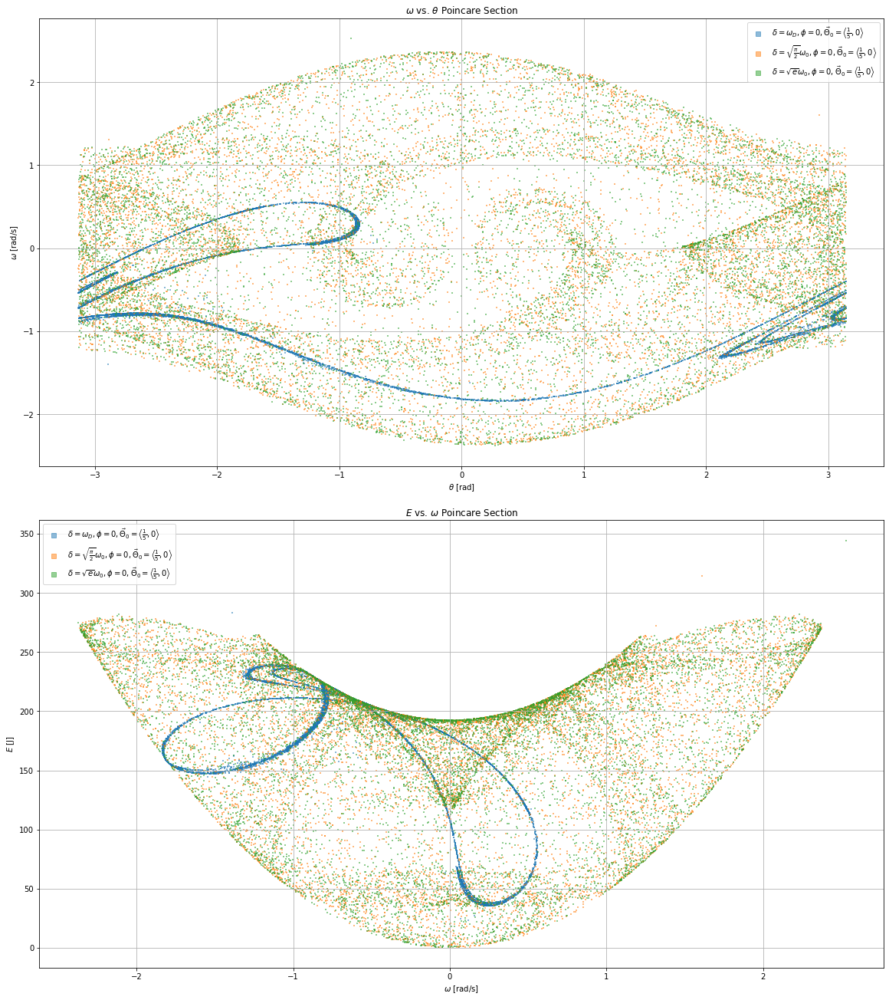

In [12]:
fig, ax = plt.subplots(2, 1, figsize=(16,18), constrained_layout=True)

ax[0].set_title(r'$\omega$ vs. $\theta$ Poincare Section')
ax[0].scatter(theta11, omega11, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[0].scatter(theta41, omega41, s=1, marker=',', alpha=0.5, label=r'$\delta=\sqrt{\frac{\pi}{2}}\omega_0,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[0].scatter(theta42, omega42, s=1, marker=',', alpha=0.5, label=r'$\delta=\sqrt{e}\omega_0,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[0].set_xlabel(r"$\theta$ [rad]")
ax[0].set_ylabel(r"$\omega$ [rad/s]")
ax[0].grid()
lgnd0 = ax[0].legend(scatterpoints=1, fontsize=10)
for handle in lgnd0.legendHandles:
    handle._sizes = [30]

ax[1].set_title(r'$E$ vs. $\omega$ Poincare Section')
ax[1].scatter(omega11, energy11, s=1, marker=',', alpha=0.5, label=r'$\delta=\omega_D,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[1].scatter(omega41, energy41, s=1, marker=',', alpha=0.5, label=r'$\delta=\sqrt{\frac{\pi}{2}}\omega_0,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[1].scatter(omega42, energy42, s=1, marker=',', alpha=0.5, label=r'$\delta=\sqrt{e}\omega_0,\phi=0,\vec{\Theta}_0=\left<\frac{1}{5},0\right>$')
ax[1].set_xlabel(r"$\omega$ [rad/s]")
ax[1].set_ylabel(r"$E$ [J]")
ax[1].grid()
lgnd1 = ax[1].legend(scatterpoints=1, fontsize=10)
for handle in lgnd1.legendHandles:
    handle._sizes = [30]

plt.savefig('problem4.png', dpi=600)
# plt.show()

In [ ]:
# from scipy.integrate import DenseOutput, OdeSolver
# from scipy.integrate._ivp.common import (validate_max_step, validate_tol, select_initial_step,
#                      norm, warn_extraneous, validate_first_step)


# # Multiply steps computed from asymptotic behaviour of errors by this.
# SAFETY = 0.9

# MIN_FACTOR = 0.2  # Minimum allowed decrease in a step size.
# MAX_FACTOR = 10  # Maximum allowed increase in a step size.

# class VelocityVerlet(OdeSolver):

#     order = 4
#     error_estimator_order = 4
#     n_stages = 2

#     def __init__(self, fun, t0, y0, t_bound, max_step=np.inf,
#                  rtol=1e-3, atol=1e-6, vectorized=False,
#                  support_complex=False, first_step=None, **extraneous):
#         warn_extraneous(extraneous)
#         super(VelocityVerlet, self).__init__(fun, t0, y0, t_bound, vectorized, support_complex, **extraneous)

#         self.length = len(y0)
#         self.split_idx = self.length//2
#         self.order = 2
#         self.n_stages = 2
#         self.error_estimator_order = 4

#         self.y_old = None
#         self.max_step = validate_max_step(max_step)
#         self.rtol, self.atol = validate_tol(rtol, atol, self.n)
#         self.f = self.fun(self.t, self.y)
#         if first_step is None:
#             self.h_abs = select_initial_step(
#                 self.fun, self.t, self.y, self.f, self.direction,
#                 self.error_estimator_order, self.rtol, self.atol)
#         else:
#             self.h_abs = validate_first_step(first_step, t0, t_bound)
#         self.error_exponent = -1 / (self.error_estimator_order + 1)
#         self.h_previous = None


#     # From: https://www.theorphys.science.ru.nl/people/fasolino/sub_java/pendula/computational-en.shtml
#     def _estimate_error(self, h):
#         ##############################################################
#         x_n, v_n = self.y[:self.split_idx], self.y[self.split_idx:]
#         a_n = self.fun(self.t, self.y)
#         dx_n, dv_n = a_n[:self.split_idx], a_n[self.split_idx:]

#         x_full_step = x_n + v_n * h + 0.5 * dv_n * h ** 2
#         x_half_step = x_n + v_n * (0.5 * h) + 0.5 * dv_n * (0.5 * h) ** 2
#         return (8.0/7.0)*np.abs(x_full_step - x_half_step)
#         ##############################################################

#     def _estimate_error_norm(self, h, scale):
#         return norm(self._estimate_error(h) / scale)

#     def _step_impl(self):
#         t = self.t
#         y = self.y
#         print(y.shape)

#         max_step = self.max_step
#         rtol = self.rtol
#         atol = self.atol

#         min_step = 10 * np.abs(np.nextafter(t, np.inf) - t)

#         if self.h_abs > max_step:
#             h_abs = max_step
#         elif self.h_abs < min_step:
#             h_abs = min_step
#         else:
#             h_abs = self.h_abs

#         step_accepted = False
#         step_rejected = False

#         while not step_accepted:
#             if h_abs < min_step:
#                 return False, self.TOO_SMALL_STEP

#             h = h_abs
#             t_new = t + h

#             if t_new - self.t_bound > 0:
#                 t_new = self.t_bound

#             h = t_new - t
#             h_abs = np.abs(h)

# ##################################################################################

#             x, v = self.y[:self.split_idx], self.y[self.split_idx:]
#             a = self.fun(self.t, self.y)
#             dx, dv = a[:self.split_idx], a[self.split_idx:]

#             x_new = x + v * h + 0.5 * dv * h ** 2
#             y_new = np.concatenate((x_new, dx))  ## Does not take into account velocity dependent forces

#             a_new = self.fun(self.t, y_new)
#             dx_new, dv_new = np.hsplit(np.asarray(a_new), 2)
#             v_new = v + 0.5 * (dv + dv_new) * h

#             y_new = np.concatenate((x_new, v_new))
#             f_new = self.fun(t + h, y_new)
# ##################################################################################

#             scale = atol + np.maximum(np.abs(y), np.abs(y_new)) * rtol
#             error_norm = self._estimate_error_norm(h, scale)

#             if error_norm < 1:
#                 if error_norm == 0:
#                     factor = MAX_FACTOR
#                 else:
#                     factor = min(MAX_FACTOR, SAFETY * error_norm ** self.error_exponent)

#                 if step_rejected:
#                     factor = min(1, factor)

#                 h_abs *= factor

#                 step_accepted = True
#             else:
#                 h_abs *= max(MIN_FACTOR, SAFETY * error_norm ** self.error_exponent)
#                 step_rejected = True

#         self.h_previous = h
#         self.y_old = y

#         self.t = t_new
#         self.y = y_new

#         self.h_abs = h_abs
#         self.f = f_new

#         return True, None


#     def _dense_output_impl(self):
#         return MyDenseOutput(self.t_old, self.t, self.h_abs, self.y, self.y_old)


# class MyDenseOutput(DenseOutput):
#     def __init__(self, t_old, t, h, y, y_old):
#         super(MyDenseOutput, self).__init__(t_old, t)
#         self.h = h
#         self.y = y
#         self.y_old = y_old

#     def _call_impl(self, t):
#         x_old, v_old = np.hsplit(np.asarray(self.y_old), 2)
#         x_new, v_new = np.hsplit(np.asarray(self.y), 2)

#         x_approx = x_old + (t - self.t_old) * (x_new - x_old) / self.h
#         v_approx = v_old + (t - self.t_old) * (v_new - v_old) / self.h

#         return np.concatenate((x_approx, v_approx))